In [1]:
import sys
sys.path.append('../py_mesa')
import mesa_reader as mr
#import mesa_manager as mm
#import webplotdigitizer as wpd


import numpy as np

from matplotlib import colors
from matplotlib import rc
from matplotlib import rcParams
rc('font', **{'family': 'serif', 'serif': ['Computer Modern']})
rcParams['text.usetex'] = True
rcParams['text.latex.unicode'] = True
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 25})
rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]
from matplotlib.animation import FuncAnimation

keV2erg = 1.60218e-9
GeV2keV = 1e6
Rsol2cm = 6.957e10
K2keV = 0.086/1e6
m_u = .931*GeV2keV
g2GeV = 5.61e23
cm2GeVinv = 1/1.98e-14
GeV2sinv = 1.52e24
alpha_EM = 1./137
pc2cm = 3.086e+18
keV2difflum = keV2erg*GeV2sinv/GeV2keV # converts keV to erg/s/keV

/usr/lib/python3/dist-packages/ipykernel_launcher.py:15: MatplotlibDeprecationWarning: 
The text.latex.unicode rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2.
  from ipykernel import kernelapp as app


In [18]:
# Write the output as an h5 file, compressing the detector response
data_file = '../data/RG_mass_1p3solar.npz'
npzfile=np.load(data_file, allow_pickle=True, encoding='latin1')
print(sorted(npzfile.files))

logT_eff_arr = npzfile['logT_eff']
logL_arr = npzfile['logL']
T_arr = npzfile['T']
R_arr = npzfile['R']
rho_arr = npzfile['rho']
X_arr = npzfile['X']
age_arr = npzfile['age']
mass_arr = npzfile['mass']


['R', 'T', 'X', 'age', 'logL', 'logT_eff', 'mass', 'rho']


[array([  4259.78031206,   4259.78075329,   4259.78138362,   4259.78232912,
         4259.7845353 ,   4259.78768698,   4259.79241453,   4259.8018697 ,
         4259.81605265,   4259.83181179,   4259.85545093,   4259.90273097,
         4259.99729807,   4260.1391698 ,   4260.2968343 ,   4260.53337492,
         4261.00663156,   4261.95384597,   4263.50718763,   4265.35300012,
         4268.12762372,   4272.57411832,   4277.78214583,   4285.6853267 ,
         4296.42098231,   4312.9194654 ,   4329.92083223,   4347.40055537,
         4371.47820109,   4396.42698111,   4415.70116272,   4435.46612513,
         4462.53838224,   4483.35757413,   4501.07455896,   4519.06989287,
         4541.07578714,   4571.00229008,   4601.61438673,   4624.96626172,
         4644.74756355,   4666.76917221,   4695.32446937,   4739.01315134,
         4781.45686516,   4820.61748436,   4862.88476022,   4897.02984506,
         4929.63502855,   4975.14729403,   5017.2169482 ,   5055.677039  ,
         5095.70300002, 

In [20]:
mass = 1.3
rgnum = str(int(10*mass-2))

base = '/scratch/bsafdi_root/bsafdi/dessert/MESA_models/RG/RG'+rgnum+'_v4/'
logs = base + 'LOGS'
history = logs + '/history.data'

l = mr.MesaLogDir(logs)
h = mr.MesaData(history)

model_num = h.model_number

BadPathError: /scratch/bsafdi_root/bsafdi/dessert/MESA_models/RG/RG11_v4/LOGS is not a valid directory.

In [21]:
logT_eff_arr = []
logL_arr = []
T_arr = []
R_arr = []
M_arr = []
dR_arr = []
rho_arr = []
X_arr = []
Y_arr = []
ZC_arr = []
ZO_arr = []
eta_arr = []
age_arr = []
mass_arr = []

for mn in model_num:
    try:
        p = l.profile_data(model_number=mn)
    except:
        continue

    logT_eff_arr += [np.log10(p.Teff)]
    logL_arr += [np.log10(p.photosphere_L)]
    T_arr += [10 ** p.logT]
    R_arr += [10 ** p.logR]
    M_arr += [p.mass/p.star_mass]
    dR_arr += [p.dr/Rsol2cm]
    rho_arr += [10 ** p.logRho]
    X_arr += [10 ** p.log_h1]
    Y_arr += [10 ** p.log_he4]
    ZC_arr += [10 ** p.log_c12]
    ZO_arr += [10 ** p.log_o16]
    eta_arr += [p.eta]
    age_arr += [p.star_age]
    
logT_eff_arr = np.array(logT_eff_arr)
logL_arr = np.array(logL_arr)
age_arr = np.array(age_arr)


NameError: name 'model_num' is not defined

In [23]:
Tmax = np.array([Tprof.max() for Tprof in T_arr])
Targmax = np.array([Tprof.argmax() for Tprof in T_arr])
Tcore = np.array([Tprof[-1] for Tprof in T_arr])
dTcoredt = (Tcore[:-1]-Tcore[1:])/(age_arr[:-1]-age_arr[1:])
Ycore = np.array([Yprof[-1] for Yprof in Y_arr])
Yhot = np.array([Y_arr[i][Targmax[i]] for i in range(len(Y_arr))])

TypeError: unsupported operand type(s) for -: 'list' and 'list'

In [22]:
idx_near_HF = np.where((Tmax > Tcore) & (Ycore > 0.5))[0][0]
idx_initial_HF_start = np.argmin(dTcoredt)
idx_initial_HF_max_temp = np.argmax(Tmax)
idx_HF_end = np.argmax(dTcoredt)+1
print age_arr[idx_near_HF]
print age_arr[idx_initial_HF_start]
print age_arr[idx_initial_HF_max_temp]
print age_arr[idx_HF_end]


SyntaxError: Missing parentheses in call to 'print'. Did you mean print(age_arr[idx_near_HF])? (<ipython-input-22-db3c73c4d763>, line 5)

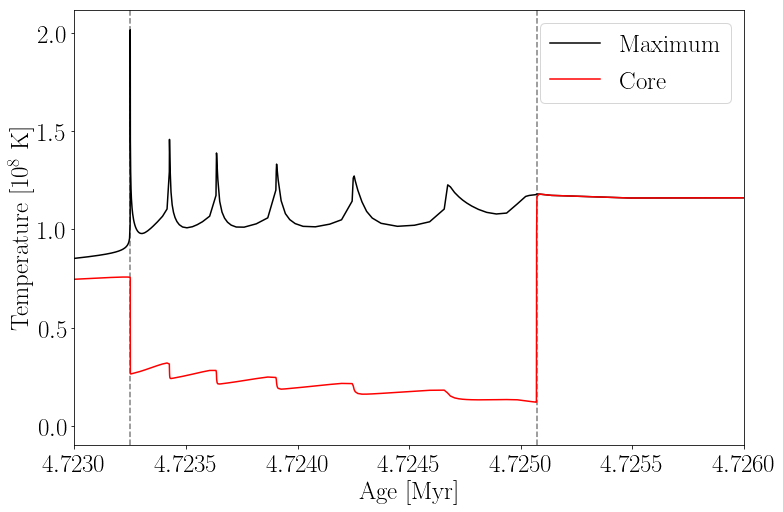

In [43]:
plt.figure(figsize=(12,8))
plt.plot(age_arr/1e9,Tmax/1e8,label='Maximum',color='k')
plt.plot(age_arr/1e9,Tcore/1e8,label='Core',color='r')
plt.axvline(age_arr[idx_initial_HF_start]/1e9,linestyle='--',color='gray',zorder=0)
plt.axvline(age_arr[idx_HF_end]/1e9,linestyle='--',color='gray',zorder=0)
plt.xlabel('Age [Myr]')
plt.ylabel('Temperature [10$^8$ K]')
plt.xlim(4.723,4.726)
plt.legend(loc='upper right')

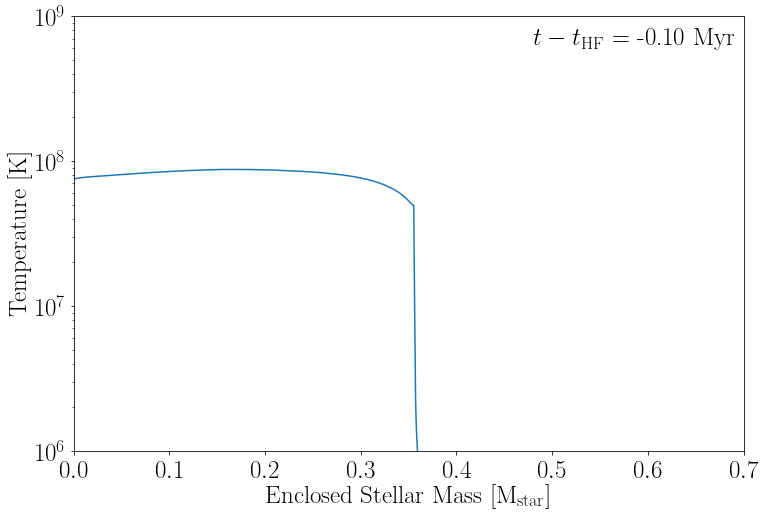

In [55]:
fig, ax = plt.subplots(figsize=(12,8))

idx_start = idx_initial_HF_start-50
# frames = np.linspace(idx_near_HF, idx_HF_end, idx_HF_end-idx_near_HF+1,dtype=np.int32)
frames = np.linspace(idx_initial_HF_start-50, idx_HF_end+10, idx_HF_end-idx_initial_HF_start+61,dtype=np.int32)
xdata = [M_arr[frame] for frame in frames]
ydata = [T_arr[frame] for frame in frames]

the_plot = plt.plot(xdata[0], ydata[0])[0]
ax.set_xlim(1e-4,0.7)
ax.set_ylim(1e6,1e9)
# ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Enclosed Stellar Mass [M$_{\\rm star}$]')
ax.set_ylabel('Temperature [K]')
title = ax.text(4.8e-1,6e8,'$t - t_{\\rm HF}$' + ' = {:.2f} Myr'.format((age_arr[frames[0]]-age_arr[idx_initial_HF_start])/1e6))
    
def animate(i):
    the_plot.set_xdata(xdata[i])
    the_plot.set_ydata(ydata[i])
    title.set_text('$t - t_{\\rm HF}$' + ' = {:.2f} Myr'.format((age_arr[frames[i]]-age_arr[idx_initial_HF_start])/1e6))

anim = FuncAnimation(
    fig, animate, interval=100, frames=len(frames))

from IPython.display import HTML
HTML(anim.to_jshtml())

In [56]:
anim.save('../plots/temperature_profile.gif', writer='imagemagick', fps=8)

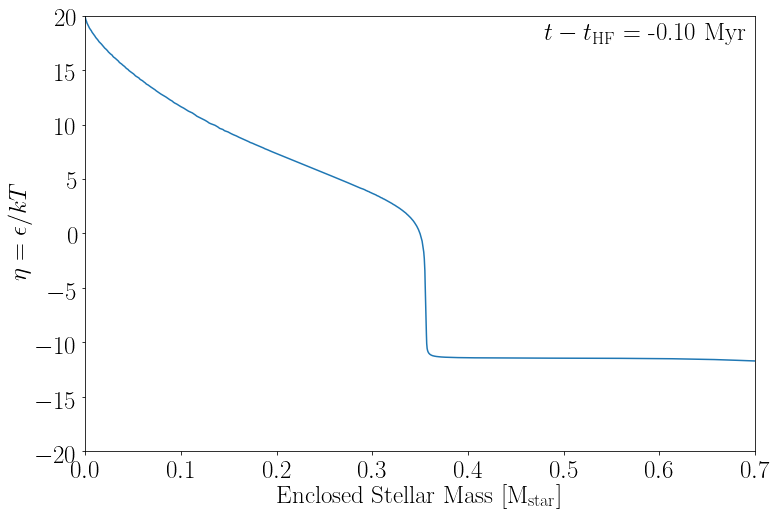

In [59]:
fig, ax = plt.subplots(figsize=(12,8))

idx_start = idx_initial_HF_start-50
# frames = np.linspace(idx_near_HF, idx_HF_end, idx_HF_end-idx_near_HF+1,dtype=np.int32)
frames = np.linspace(idx_initial_HF_start-50, idx_HF_end+10, idx_HF_end-idx_initial_HF_start+61,dtype=np.int32)
xdata = [M_arr[frame] for frame in frames]
ydata = [eta_arr[frame] for frame in frames]

the_plot = plt.plot(xdata[0], ydata[0])[0]
ax.set_xlim(1e-4,0.7)
ax.set_ylim(-20,20)
ax.set_xlabel('Enclosed Stellar Mass [M$_{\\rm star}$]')
ax.set_ylabel('$\eta = \epsilon/kT$')
title = ax.text(4.8e-1,17.5,'$t - t_{\\rm HF}$' + ' = {:.2f} Myr'.format((age_arr[frames[0]]-age_arr[idx_initial_HF_start])/1e6))
    
def animate(i):
    the_plot.set_xdata(xdata[i])
    the_plot.set_ydata(ydata[i])
    title.set_text('$t - t_{\\rm HF}$' + ' = {:.2f} Myr'.format((age_arr[frames[i]]-age_arr[idx_initial_HF_start])/1e6))

anim = FuncAnimation(
    fig, animate, interval=100, frames=len(frames))

from IPython.display import HTML
HTML(anim.to_jshtml())

In [60]:
anim.save('../plots/degeneracy_profile.gif', writer='imagemagick', fps=8)

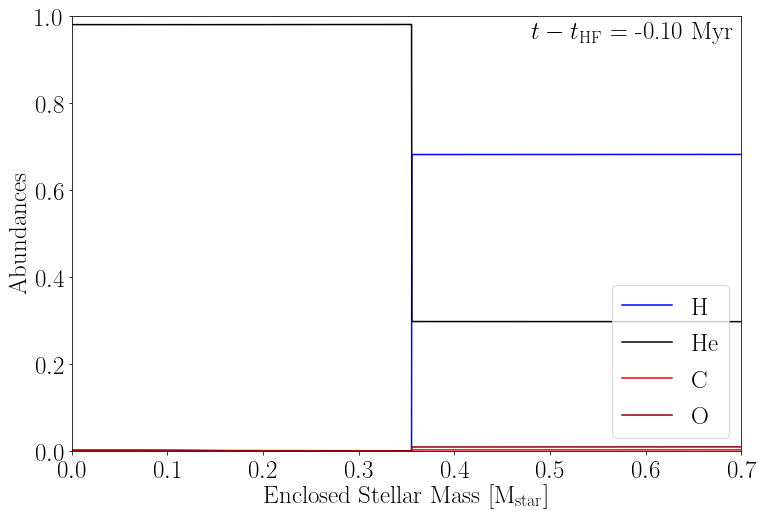

In [86]:
fig, ax = plt.subplots(figsize=(12,8))

idx_start = idx_initial_HF_start-50
# frames = np.linspace(idx_near_HF, idx_HF_end, idx_HF_end-idx_near_HF+1,dtype=np.int32)
frames = np.linspace(idx_initial_HF_start-50, idx_HF_end+10, idx_HF_end-idx_initial_HF_start+61,dtype=np.int32)
xdata = [M_arr[frame] for frame in frames]
hdata = [X_arr[frame] for frame in frames]
hedata = [Y_arr[frame] for frame in frames]
cdata = [ZC_arr[frame] for frame in frames]
odata = [ZO_arr[frame] for frame in frames]

h_plot = plt.plot(xdata[0], hdata[0],label='H',color='b')[0]
he_plot = plt.plot(xdata[0], hedata[0],label='He',color='black')[0]
c_plot = plt.plot(xdata[0], metaldata[0],label='C',color='r')[0]
o_plot = plt.plot(xdata[0], metaldata[0],label='O',color='darkred')[0]
ax.set_xlim(1e-4,0.7)
ax.set_ylim(0,1)
ax.set_xlabel('Enclosed Stellar Mass [M$_{\\rm star}$]')
ax.set_ylabel('Abundances')
ax.legend(loc='lower right')
title = ax.text(4.8e-1,.94,'$t - t_{\\rm HF}$' + ' = {:.2f} Myr'.format((age_arr[frames[0]]-age_arr[idx_initial_HF_start])/1e6))
    
def animate(i):
    h_plot.set_xdata(xdata[i])
    he_plot.set_xdata(xdata[i])
    c_plot.set_xdata(xdata[i])
    o_plot.set_xdata(xdata[i])
    h_plot.set_ydata(hdata[i])
    he_plot.set_ydata(hedata[i])
    c_plot.set_ydata(cdata[i])
    o_plot.set_ydata(odata[i])
    title.set_text('$t - t_{\\rm HF}$' + ' = {:.2f} Myr'.format((age_arr[frames[i]]-age_arr[idx_initial_HF_start])/1e6))

anim = FuncAnimation(
    fig, animate, interval=100, frames=len(frames))

from IPython.display import HTML
HTML(anim.to_jshtml())

In [87]:
anim.save('../plots/abundance_profile.gif', writer='imagemagick', fps=8)

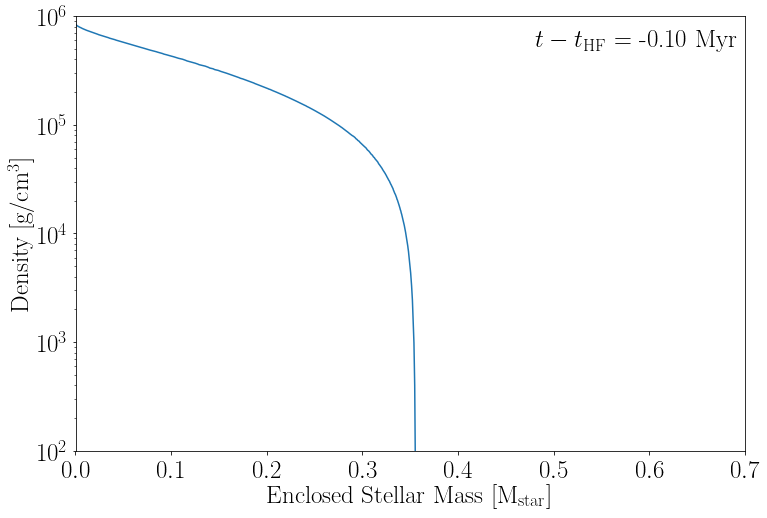

In [9]:
fig, ax = plt.subplots(figsize=(12,8))

idx_start = idx_initial_HF_start-50
# frames = np.linspace(idx_near_HF, idx_HF_end, idx_HF_end-idx_near_HF+1,dtype=np.int32)
frames = np.linspace(idx_initial_HF_start-50, idx_HF_end+10, idx_HF_end-idx_initial_HF_start+61,dtype=np.int32)
xdata = [M_arr[frame] for frame in frames]
ydata = [rho_arr[frame] for frame in frames]

the_plot = plt.plot(xdata[0], ydata[0])[0]
ax.set_xlim(1e-4,0.7)
ax.set_ylim(1e2,1e6)
ax.set_yscale('log')
ax.set_xlabel('Enclosed Stellar Mass [M$_{\\rm star}$]')
ax.set_ylabel('Density [g/cm$^3$]')
title = ax.text(4.8e-1,4.8e5,'$t - t_{\\rm HF}$' + ' = {:.2f} Myr'.format((age_arr[frames[0]]-age_arr[idx_initial_HF_start])/1e6))
    
def animate(i):
    the_plot.set_xdata(xdata[i])
    the_plot.set_ydata(ydata[i])
    title.set_text('$t - t_{\\rm HF}$' + ' = {:.2f} Myr'.format((age_arr[frames[i]]-age_arr[idx_initial_HF_start])/1e6))

anim = FuncAnimation(
    fig, animate, interval=100, frames=len(frames))

from IPython.display import HTML
HTML(anim.to_jshtml())

In [ ]:
idx_plot = idx_initial_HF_start

plt.figure(1,figsize=(10,8))
plt.plot(R_arr[idx_plot],rho_arr[idx_plot])
plt.xscale('log')
plt.yscale('log')
plt.xlabel('R [Rsol]')
plt.ylabel('Density [g/cm$^3$]')

plt.figure(2,figsize=(10,8))
plt.plot(R_arr[idx_plot],T_arr[idx_plot])
plt.ylim(1e6,1e9)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('R [Rsol]')
plt.ylabel('Temperature [K]')

plt.figure(3,figsize=(10,8))
plt.axhline(1,color='black',linestyle='--')
plt.plot(R_arr[idx_plot],X_arr[idx_plot],label='Hydrogen')
plt.plot(R_arr[idx_plot],Y_arr[idx_plot],label='Helium')
# plt.plot(R,Z_metal,label='Metals')
plt.xscale('log')
plt.yscale('log')
plt.ylim(1e-3,2)
plt.xlabel('R [Rsol]')
plt.ylabel('Mass Fraction')
plt.legend()

plt.figure(4,figsize=(10,8))
plt.plot(R_arr[idx_plot],eta_arr[idx_plot])
plt.xscale('log')
# plt.yscale('log')
plt.xlabel('R [Rsol]')
plt.ylabel('$\eta = \epsilon/kT$')

In [ ]:
mass = '1.3'
mones = mass[0]
mtenths = mass[2]
rgnum = str(int(10*float(mass)-2))
print rgnum

base = '/scratch/bsafdi_root/bsafdi/dessert/MESA_models/RG/RG'+rgnum+'_v4/'
logs = base + 'LOGS'
history = logs + '/history.data'

l = mr.MesaLogDir(logs)

logT_eff_arr = []
logL_arr = []
T_arr = []
R_arr = []
dR_arr = []
rho_arr = []
X_arr = []
Y_arr = []
eta_arr = []
age_arr = []
mass_arr = []

for mn in model_num:
    try:
        p = l.profile_data(model_number=mn)
    except:
        continue

    logT_eff_arr += [np.log10(p.Teff)]
    logL_arr += [np.log10(p.photosphere_L)]
    T_arr += [10 ** p.logT]
    R_arr += [10 ** p.logR * Rsol2cm]
    dR_arr += [p.dr]
    rho_arr += [10 ** p.logRho]
    X_arr += [p.x_mass_fraction_H]
    Y_arr += [p.y_mass_fraction_He]
    eta_arr += [p.eta]
    age_arr += [p.star_age]
    mass_arr += [p.star_mass]